In [0]:
%cd '../..'
%pwd

In [1]:
import random
import warnings
from typing import Callable

import albumentations as album
import cv2
import imutils
import numpy as np
import segmentation_models_pytorch.utils as smp_utils
from torch.utils.data import DataLoader
from torchinfo import summary

from azulvision.board_extraction.config import *
from azulvision.board_extraction.dataset import BEDataset
from azulvision.board_extraction.extract import extract_perspective, fix_mask, ignore_contours, rotate_quadrangle
from azulvision.board_extraction.model import UNet
from azulvision.board_extraction.one_hot import color_code_segmentation, reverse_one_hot
from azulvision.utils import visualize

%matplotlib inline
warnings.filterwarnings("ignore")

/home/arslan/.cache/pypoetry/virtualenvs/pr-1TEpFMsl-py3.11/lib/python3.11/site-packages/IPython/core/magics/osm.py:417: UserWarning: using dhist requires you to install the `pickleshare` library.
  self.shell.db['dhist'] = compress_dhist(dhist)[-100:]


/home/arslan/PycharmProjects/pr


In [2]:
print('All dataset classes and their corresponding RGB values in labels:')
print('Class Names: ', CLASS_NAMES)
print('Class RGB values: ', CLASS_RGB_VALUES)

All dataset classes and their corresponding RGB values in labels:
Class Names:  ['background', 'board']
Class RGB values:  [[0, 0, 0], [128, 0, 0]]


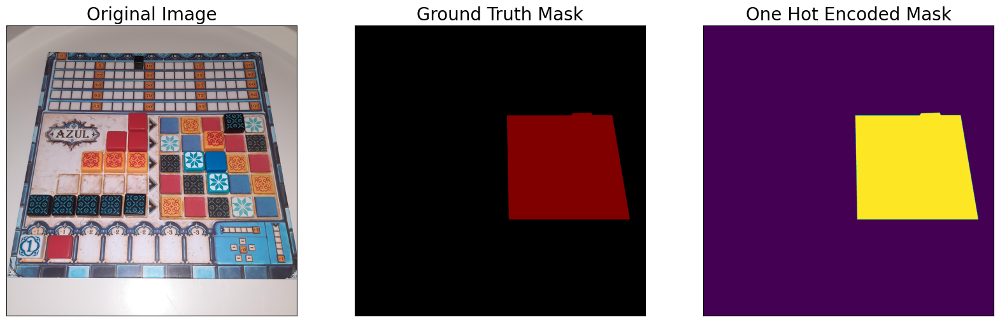

In [3]:
dataset = BEDataset(X_TRAIN_DIR, Y_TRAIN_DIR, class_rgb_values=CLASS_RGB_VALUES)
random_idx = random.randint(0, len(dataset) - 1)
image, mask = dataset[random_idx]

visualize(
    original_image=image,
    ground_truth_mask=color_code_segmentation(reverse_one_hot(mask), CLASS_RGB_VALUES),
    one_hot_encoded_mask=reverse_one_hot(mask)
)

In [4]:
training_augmentation = album.Compose([
    # album.Resize(height=IMG_SIZE, width=IMG_SIZE, always_apply=True),
    album.RandomResizedCrop(*INPUT_IMAGE_SIZE, scale=(0.25, 1.2), always_apply=True),
    album.RandomBrightness(0.2, p=0.75),
    album.OneOf([
        album.HorizontalFlip(p=1),
        album.VerticalFlip(p=1),
        album.RandomRotate90(p=1),
    ],
        p=0.75),
])

validation_augmentation = album.Compose([
    album.LongestMaxSize(max(INPUT_IMAGE_SIZE), always_apply=True),
])


def get_preprocessing(preprocessing_fn: Callable[[np.ndarray], np.ndarray] | None = None) -> album.Compose:
    def to_tensor(x: np.ndarray, **kwargs):
        _ = kwargs
        x = x.transpose(2, 0, 1).astype('float32')
        return x

    transform = []
    if preprocessing_fn:
        transform.append(album.Lambda(image=preprocessing_fn))
    transform.append(album.Lambda(image=to_tensor, mask=to_tensor))

    return album.Compose(transform)

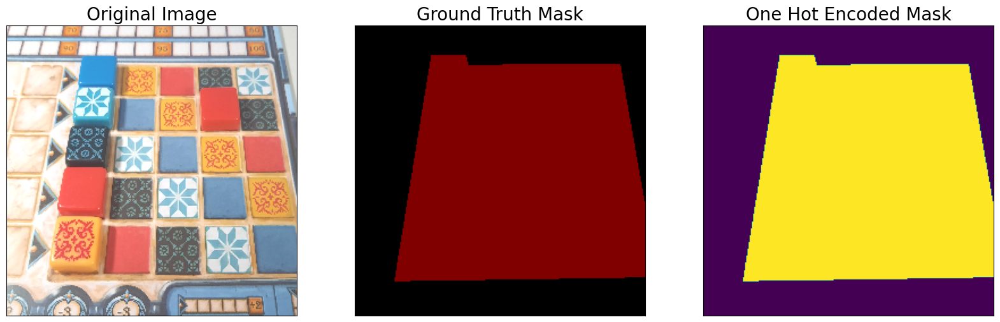

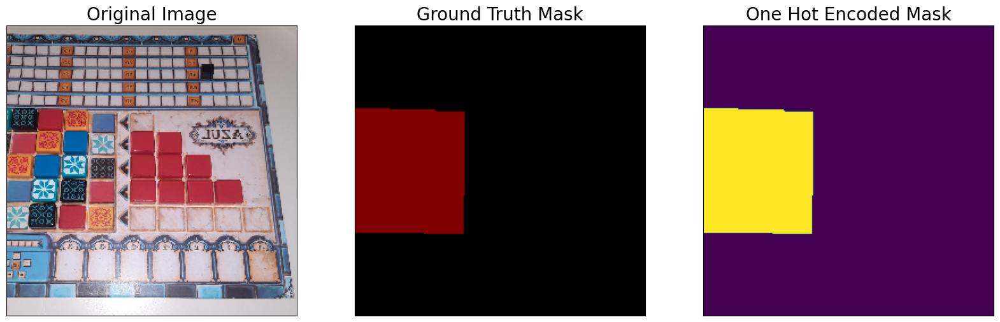

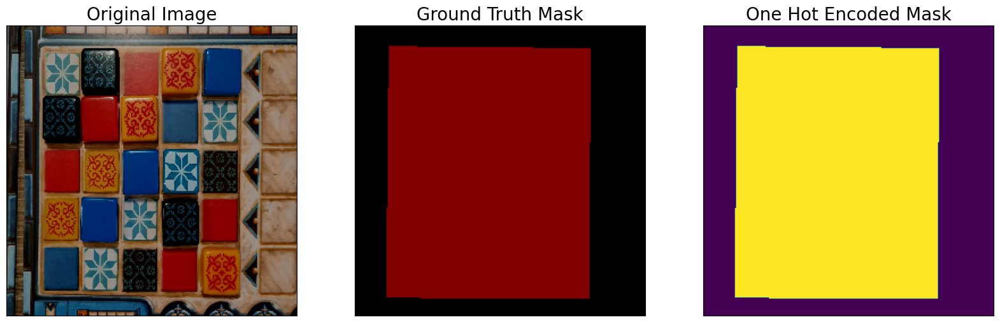

In [5]:
augmented_dataset = BEDataset(
    X_TRAIN_DIR, Y_TRAIN_DIR,
    augmentation=training_augmentation,
    class_rgb_values=CLASS_RGB_VALUES,
)

for i in range(3):
    random_idx = random.randint(0, len(augmented_dataset) - 1)
    image, mask = augmented_dataset[random_idx]
    visualize(
        original_image=image,
        ground_truth_mask=color_code_segmentation(reverse_one_hot(mask), CLASS_RGB_VALUES),
        one_hot_encoded_mask=reverse_one_hot(mask)
    )

In [6]:
train_dataset = BEDataset(
    X_TRAIN_DIR, Y_TRAIN_DIR,
    augmentation=training_augmentation,
    preprocessing=get_preprocessing(),
    class_rgb_values=CLASS_RGB_VALUES,
)

valid_dataset = BEDataset(
    X_VALID_DIR, Y_VALID_DIR,
    augmentation=validation_augmentation,
    preprocessing=get_preprocessing(),
    class_rgb_values=CLASS_RGB_VALUES,
)

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=NUM_WORKERS, pin_memory=True)
valid_loader = DataLoader(valid_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=NUM_WORKERS, pin_memory=True)

In [7]:
TRAINING = False

print(f"Using device: {DEVICE}")

model = UNet(
    in_channels=NUM_CHANNELS,
    n_classes=len(CLASS_NAMES),
    depth=NUM_LEVELS,
    wf=6,
    padding=True,
    batch_norm=True,
    up_mode='upsample'
)

loss = smp_utils.losses.CrossEntropyLoss()

metrics = [
    smp_utils.metrics.IoU(threshold=THRESHOLD)
]

optimizer = torch.optim.Adam(model.parameters())

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    patience=5,
    verbose=True
)

if MODEL_WEIGHTS:
    model = torch.load(MODEL_WEIGHTS)

summary(model, input_size=(BATCH_SIZE, 3, 224, 224))

Using device: cuda


Layer (type:depth-idx)                        Output Shape              Param #
UNet                                          [6, 2, 224, 224]          --
├─ModuleList: 1-1                             --                        --
│    └─UNetConvBlock: 2-1                     [6, 64, 224, 224]         --
│    │    └─Sequential: 3-1                   [6, 64, 224, 224]         38,976
│    └─UNetConvBlock: 2-2                     [6, 128, 112, 112]        --
│    │    └─Sequential: 3-2                   [6, 128, 112, 112]        221,952
│    └─UNetConvBlock: 2-3                     [6, 256, 56, 56]          --
│    │    └─Sequential: 3-3                   [6, 256, 56, 56]          886,272
│    └─UNetConvBlock: 2-4                     [6, 512, 28, 28]          --
│    │    └─Sequential: 3-4                   [6, 512, 28, 28]          3,542,016
│    └─UNetConvBlock: 2-5                     [6, 1024, 14, 14]         --
│    │    └─Sequential: 3-5                   [6, 1024, 14, 14]         14

In [8]:
train_epoch = smp_utils.train.TrainEpoch(
    model,
    loss=loss,
    metrics=metrics,
    optimizer=optimizer,
    device=DEVICE,
    verbose=True,
)

valid_epoch = smp_utils.train.ValidEpoch(
    model,
    loss=loss,
    metrics=metrics,
    device=DEVICE,
    verbose=True,
)

In [9]:
%%time

if TRAINING:
    best_iou_score = 0.0
    train_logs_list, valid_logs_list = [], []
    counter = 0
    patience = 10

    for i in range(0, NUM_EPOCHS):
        print(f"\nEPOCH: {i}")

        train_logs = train_epoch.run(train_loader)
        valid_logs = valid_epoch.run(valid_loader)
        train_logs_list.append(train_logs)
        valid_logs_list.append(valid_logs)

        scheduler.step(valid_logs['cross_entropy_loss'])

        if best_iou_score < valid_logs['iou_score']:
            best_iou_score = valid_logs['iou_score']
            torch.save(model, MODEL_WEIGHTS)
            counter = 0
            print('Model saved!')
        else:
            counter += 1
            if counter > patience:
                break

CPU times: user 2 µs, sys: 1 µs, total: 3 µs
Wall time: 7.39 µs


In [10]:
if MODEL_WEIGHTS:
    model = torch.load(MODEL_WEIGHTS)
    print("Loaded UNet model from this run.")

Loaded UNet model from this run.


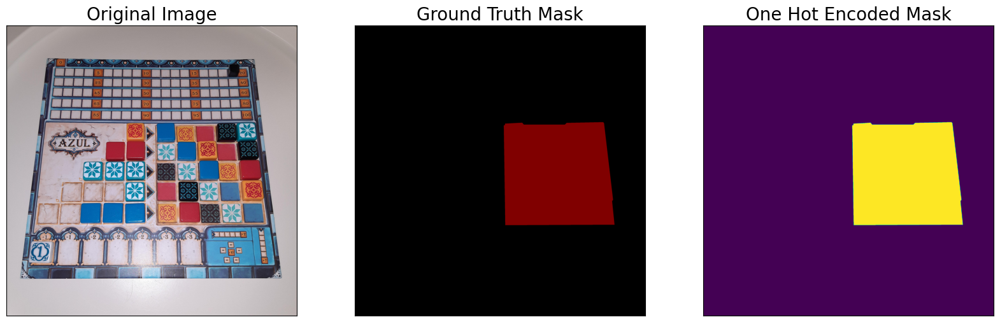

In [11]:
test_dataset = BEDataset(
    X_TEST_DIR,
    Y_TEST_DIR,
    augmentation=validation_augmentation,
    preprocessing=get_preprocessing(),
    class_rgb_values=CLASS_RGB_VALUES
)

test_dataloader = DataLoader(test_dataset)

test_dataset_vis = BEDataset(
    X_TEST_DIR,
    Y_TEST_DIR,
    # augmentation=validation_augmentation,
    class_rgb_values=CLASS_RGB_VALUES
)

random_idx = random.randint(0, len(test_dataset_vis) - 1)
image, mask = test_dataset_vis[random_idx]

visualize(
    original_image=image,
    ground_truth_mask=color_code_segmentation(reverse_one_hot(mask), CLASS_RGB_VALUES),
    one_hot_encoded_mask=reverse_one_hot(mask)
)

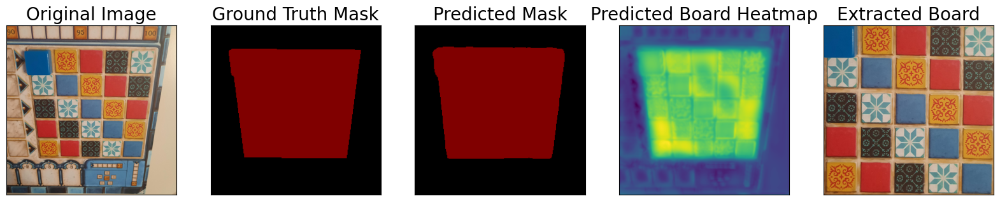

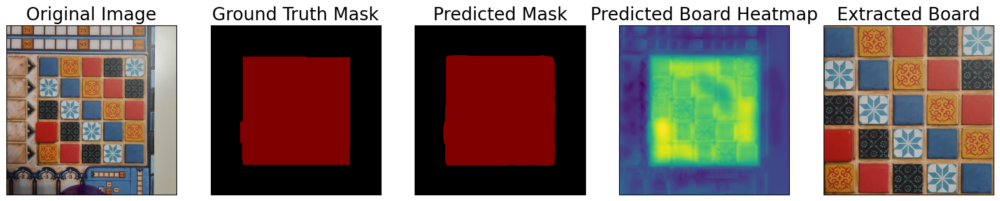

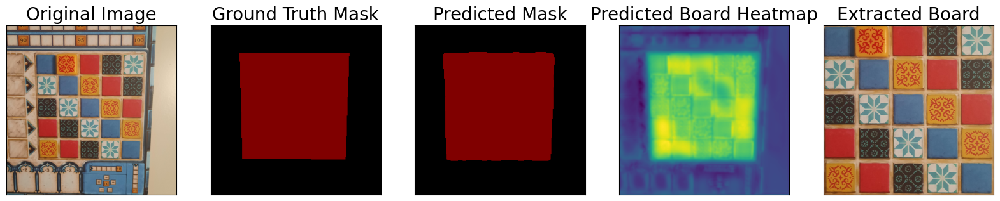

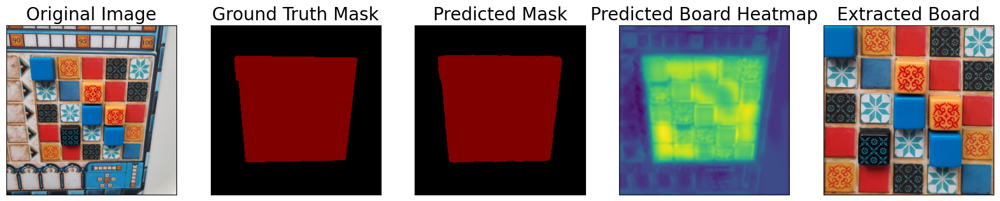

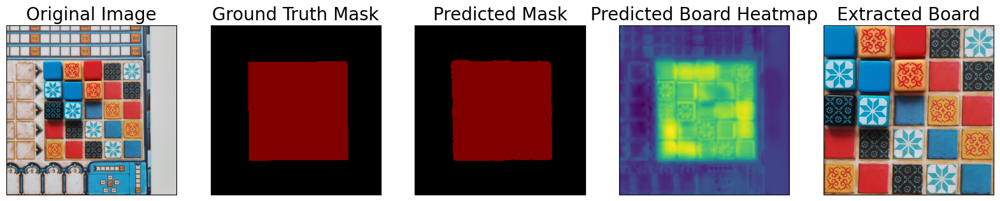

...

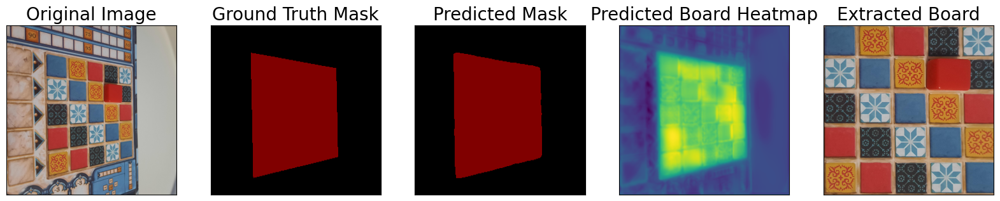

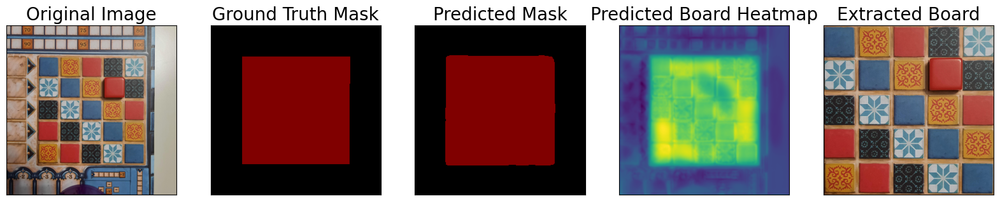

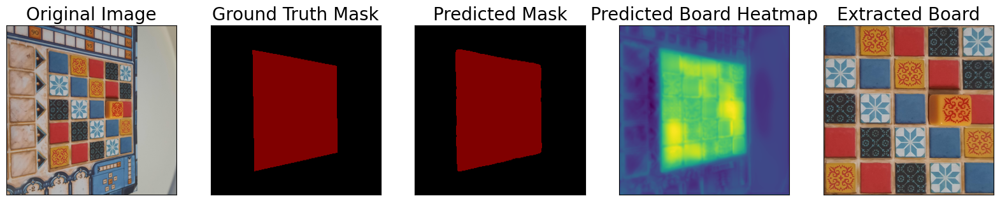

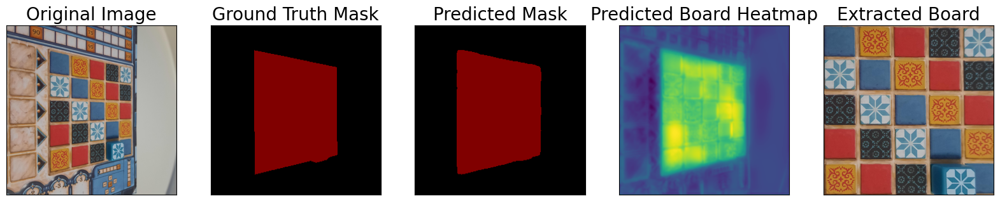

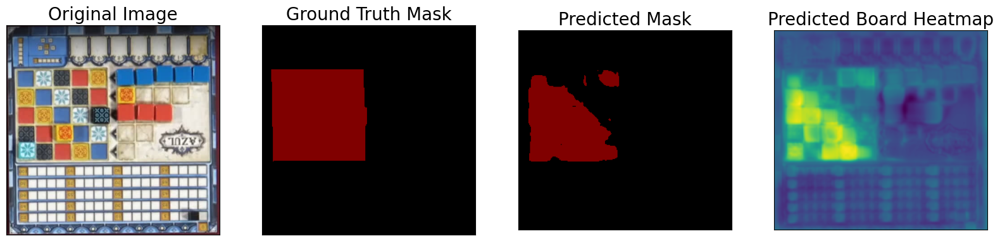

In [12]:
from azulvision.board_extraction.extract import scale_approx

model.eval()
for idx in range(len(test_dataset)):
    image, gt_mask = test_dataset[idx]
    image_vis = test_dataset_vis[idx][0].astype('uint8')
    x_tensor = torch.from_numpy(image).to(DEVICE).unsqueeze(0)
    # Predict test image
    pred_mask = model(x_tensor)
    pred_mask = pred_mask.detach().squeeze().cpu().numpy()
    # Convert pred_mask from `CHW` format to `HWC` format
    pred_mask = np.transpose(pred_mask, (1, 2, 0))
    # Get prediction channel corresponding to building
    pred_building_heatmap = pred_mask[:, :, CLASS_NAMES.index('board')]
    for_contour = reverse_one_hot(pred_mask)

    pred_mask = color_code_segmentation(reverse_one_hot(pred_mask), CLASS_RGB_VALUES)
    # Convert gt_mask from `CHW` format to `HWC` format
    gt_mask = np.transpose(gt_mask, (1, 2, 0))
    gt_mask = color_code_segmentation(reverse_one_hot(gt_mask), CLASS_RGB_VALUES)

    contours = cv2.findContours(fix_mask(for_contour, threshold=0.5), cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
    contours = imutils.grab_contours(contours)

    if len(contours) > 1:
        contours = ignore_contours(pred_mask.shape, contours)

    approx = None
    if len(contours) > 0:
        for i in range(len(contours)):
            cnt = contours[i]
            arclen = cv2.arcLength(cnt, True)
            candidate = cv2.approxPolyDP(cnt, 0.1 * arclen, True)

            if len(candidate) != 4:
                continue

            approx = rotate_quadrangle(candidate)
            break

    if approx is not None:
        approx = scale_approx(approx, image_vis.shape)
        board = extract_perspective(image_vis, approx, BOARD_IMAGE_SIZE)
        board = cv2.flip(board, 1)
        # board = cv2.cvtColor(board, cv2.COLOR_RGB2GRAY)
        visualize(
            original_image=image_vis,
            ground_truth_mask=gt_mask,
            predicted_mask=pred_mask,
            predicted_board_heatmap=pred_building_heatmap,
            extracted_board=board
        )
    else:
        visualize(
            original_image=image_vis,
            ground_truth_mask=gt_mask,
            predicted_mask=pred_mask,
            predicted_board_heatmap=pred_building_heatmap
        )

    del x_tensor
